In [1]:
%cd C:\Users\mdieh
!git clone https://github.com/WongKinYiu/yolov7.git
%cd yolov7
# !wget https://raw.githubusercontent.com/WongKinYiu/yolov7/u5/requirements.txt
!pip install -r requirements.txt

[WinError 2] The system cannot find the file specified: 'C:\\Users\\mdieh'
C:\Users\mdiehl
C:\Users\mdiehl\yolov7


fatal: destination path 'yolov7' already exists and is not an empty directory.


In [2]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [3]:
import torch

if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
torch.cuda.empty_cache()
# torch.zeros(1).cuda()

In [4]:
from roboflow import Roboflow
rf = Roboflow(api_key="5HHY7n4KGmB11S6LTqa1")
project = rf.workspace("eclipseai").project("detr-xray")
version = project.version(2)
dataset = version.download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


In [4]:
dataset.location

'C:\\Users\\mdiehl\\yolov7\\detr-xray-2'

In [6]:
!python train.py  --batch 2 --cfg cfg/training/yolov7.yaml --epochs 32 --data train_test_dataset_three_classes/omega_classes.yaml --weights 'yolov7m.pt' --device 0,1

^C


In [5]:
!python train.py  --batch 1 --cfg cfg/training/yolov7.yaml --epochs 32 --data detr-xray-2/data.yaml --weights 'yolov7m.pt' --device 1


autoanchor: Analyzing anchors... anchors/target = 4.57, Best Possible Recall (BPR) = 1.0000
                 all         577        1032     0.00916      0.0119      0.0028    0.000495
                 all         577        1032     0.00721       0.168     0.00741     0.00129
                 all         577        1032       0.349      0.0231      0.0101     0.00154
                 all         577        1032      0.0183      0.0684      0.0127      0.0021
                 all         577        1032       0.739      0.0485      0.0247      0.0063
                 all         577        1032      0.0107       0.119     0.00771     0.00138
                 all         577        1032      0.0101      0.0549     0.00568    0.000989
                 all         577        1032       0.693      0.0597      0.0128     0.00217
                 all         577        1032       0.679      0.0835     0.00809     0.00127
                 all         577        1032       0.406       0.119  

YOLOR  v0.1-128-ga207844 torch 1.11.0+cu113 CUDA:1 (NVIDIA RTX A4000, 16375.5MB)

Namespace(adam=False, artifact_alias='latest', batch_size=1, bbox_interval=-1, bucket='', cache_images=False, cfg='cfg/training/yolov7.yaml', data='detr-xray-2/data.yaml', device='1', entity=None, epochs=32, evolve=False, exist_ok=False, freeze=[0], global_rank=-1, hyp='data/hyp.scratch.p5.yaml', image_weights=False, img_size=[640, 640], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='exp', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs\\train\\exp23', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=1, upload_dataset=False, v5_metric=False, weights="'yolov7m.pt'", workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=

In [22]:
#@title Select YOLOv5 🚀 logger {run: 'auto'}
logger = 'TensorBoard' #@param ['Comet', 'ClearML', 'TensorBoard']

if logger == 'Comet':
  %pip install -q comet_ml
  import comet_ml; comet_ml.init()
elif logger == 'ClearML':
  %pip install -q clearml
  import clearml; clearml.browser_login()
elif logger == 'TensorBoard':
  %load_ext tensorboard
  %tensorboard --logdir runs/train

Reusing TensorBoard on port 6006 (pid 23532), started 2 days, 3:22:27 ago. (Use '!kill 23532' to kill it.)

In [ ]:
%ls runs\train

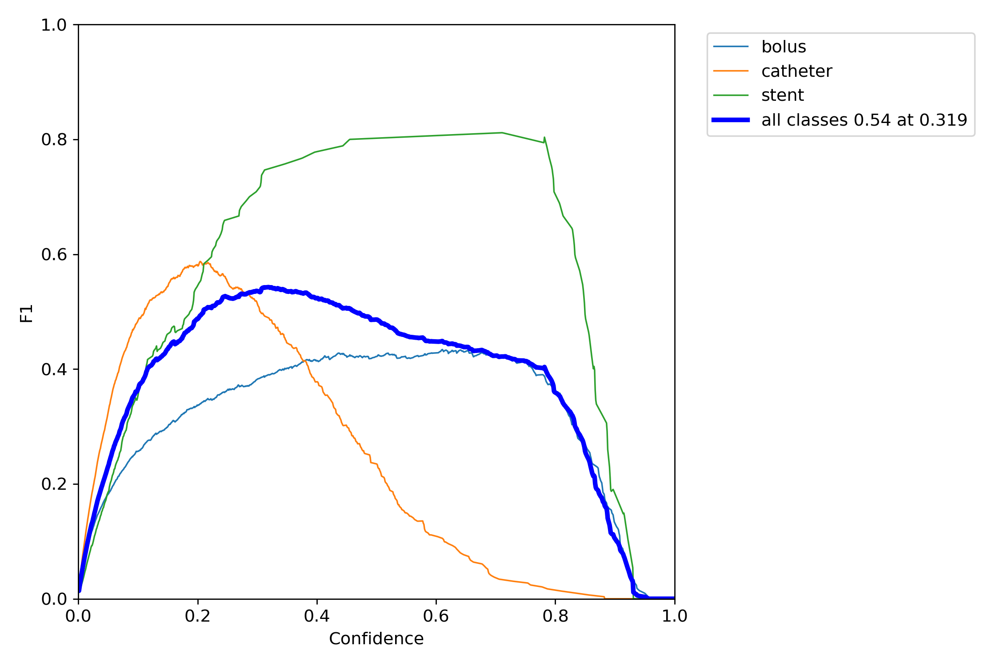

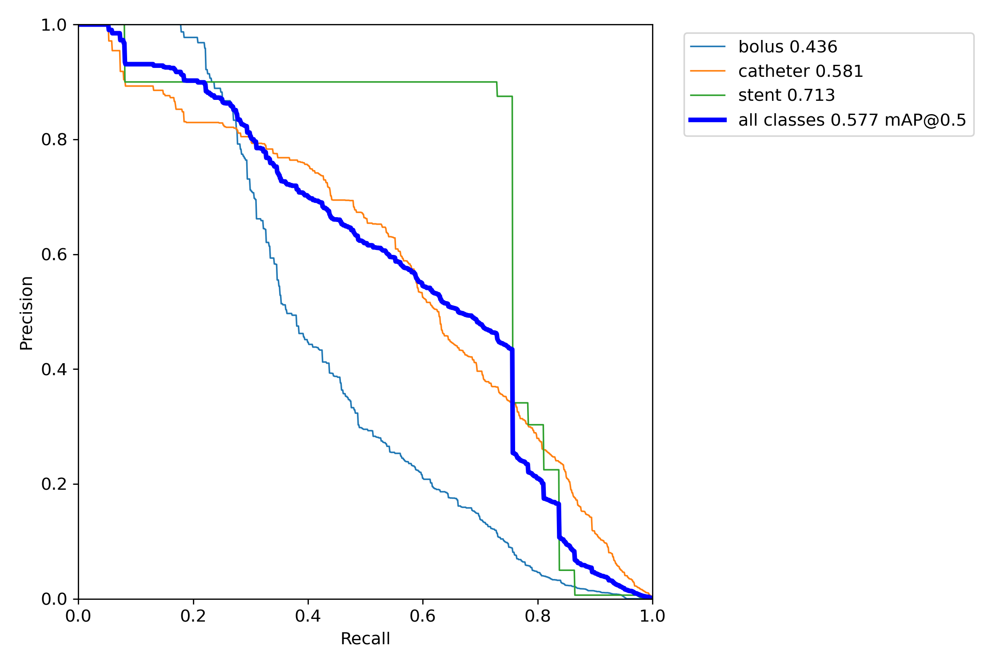

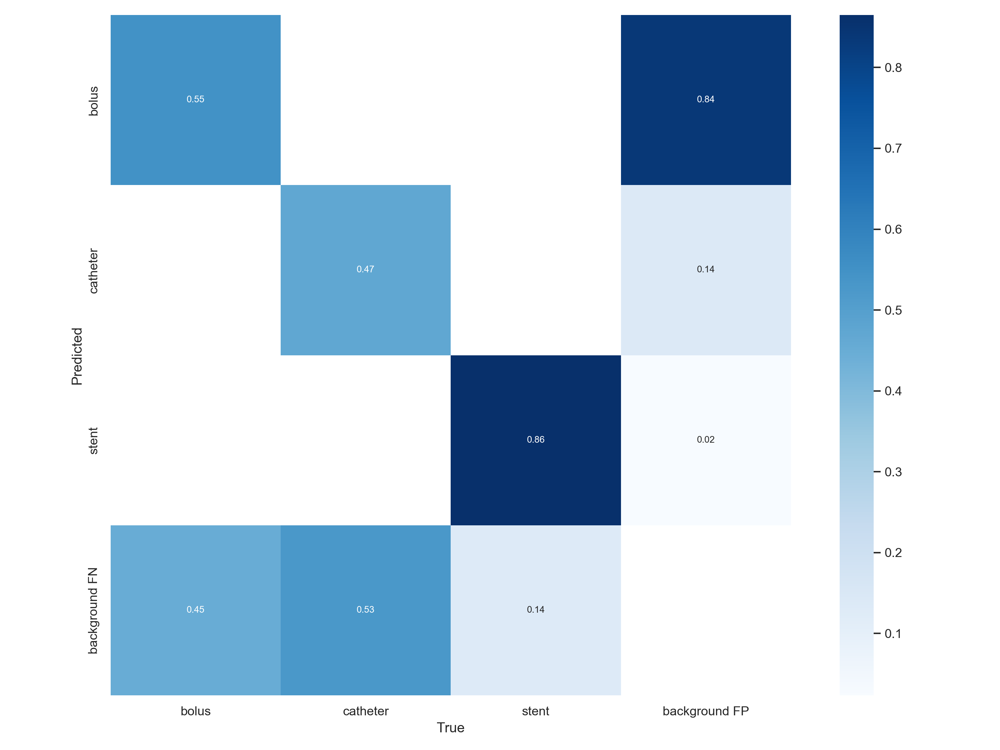

In [7]:
from IPython.display import Image
display(Image("runs/train/exp23/F1_curve.png", width=400, height=400))
display(Image("runs/train/exp23/PR_curve.png", width=400, height=400))
display(Image("runs/train/exp23/confusion_matrix.png", width=500, height=500))

In [ ]:
# Run evaluation
!python detect.py --weights runs/train/exp7/weights/last.pt --conf 0.1 --source xray-1/train_test_dataset_three_classes/images/test

In [4]:
# Run evaluation
!python detect.py --weights runs/train/exp23/weights/last.pt --conf 0.1 --source detr-xray-2/test/images

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.1, device='', exist_ok=False, img_size=640, iou_thres=0.45, name='exp', no_trace=False, nosave=False, project='runs/detect', save_conf=False, save_txt=False, source='detr-xray-2/test/images', update=False, view_img=False, weights=['runs/train/exp23/weights/last.pt'])
Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
IDetect.fuse
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

3 boluss, 2 catheters, Done. (95.7ms) Inference, (5.0ms) NMS
 The image with the result is saved in: runs\detect\exp2\XA1-1000-_jpg.rf.0b8ca8e26f8589fbbc1d692f7596e970.jpg
2 catheters, Done. (11.0ms) Inference, (1.0ms) NMS
 The image with the result is saved in: runs\detect\exp2\XA1-1006-_jpg.rf.778404a81d8cc36b48c2b02c3802e58f.jpg
1 bolus, 2 catheters, Done. (11.0ms) Inference, (1.0ms) NMS
 The image with the result is saved in: runs\detect\exp2\XA1-1011-_jpg.r

YOLOR  v0.1-128-ga207844 torch 1.11.0+cu113 CUDA:0 (NVIDIA RTX A4000, 16375.375MB)
                                             CUDA:1 (NVIDIA RTX A4000, 16375.5MB)

C:\Users\mdiehl\anaconda3\envs\eclipse-ai\lib\site-packages\torch\functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 314 layers, 36492560 parameters, 6194944 gradients, 103.2 GFLOPS


In [ ]:
!python test.py --weights runs/train/exp7/weights/best.pt --data xray-1/omega_classes.yaml

In [8]:
!python test.py --data detr-xray-2/data.yaml --img 640 --batch 16 --conf 0.001 --iou 0.65 --device 0 --weights runs/train/exp23/weights/best.pt --name yolov7_640_val

Namespace(augment=False, batch_size=16, conf_thres=0.001, data='detr-xray-2/data.yaml', device='0', exist_ok=False, img_size=640, iou_thres=0.65, name='yolov7_640_val', no_trace=False, project='runs/test', save_conf=False, save_hybrid=False, save_json=False, save_txt=False, single_cls=False, task='val', v5_metric=False, verbose=False, weights=['runs/train/exp23/weights/best.pt'])
Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
IDetect.fuse
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

                 all         577        1032       0.667       0.464       0.562       0.257
               bolus         577         419       0.394        0.36       0.387       0.136
            catheter         577         576       0.805       0.167       0.433       0.153
               stent         577          37       0.802       0.865       0.865       0.482
Speed: 8.1/1.2/9.3 ms inference/NMS/total per 640x6

YOLOR  v0.1-128-ga207844 torch 1.11.0+cu113 CUDA:0 (NVIDIA RTX A4000, 16375.375MB)

C:\Users\mdiehl\anaconda3\envs\eclipse-ai\lib\site-packages\torch\functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 314 layers, 36492560 parameters, 6194944 gradients, 103.2 GFLOPS

val: Scanning 'detr-xray-2\valid\labels.cache' images and labels... 577 found, 0 missing, 0 empty, 0 corrupted: 100%|##########| 577/577 [00:00<?, ?it/s]
val: Scanning 'detr-xray-2\valid\labels.cache' images and labels... 577 found, 0 missing, 0 empty, 0 corrupted: 100%|##########| 577/577 [00:00<?, ?it/s]

               Class      Images      Labels           P           R      mAP@.5  mAP@.5:.95:   0%|          | 0/37 [00:00<?, ?it/s]

In [6]:
!git pull

Already up to date.


In [6]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib
import glob
matplotlib.use('TkAgg')

In [ ]:
ROI_dir = 'C:\\Users\\mdiehl\\yolov7\\detr-xray-2\\ROI'
# load local pretrained yolov5 model
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
path = 'C:/Users/mdiehl/yolov7/runs/train/exp23/weights/best.pt'
model = torch.hub.load("WongKinYiu/yolov7","custom",f"{path}")
image_list = []
i = 0
for filename in glob.glob('C:\\Users\\mdiehl\\yolov7\\detr-xray-2\\test\\images\\*.jpg'): #assuming gif
    i += 1
    image=Image.open(filename)
    print(filename)
    # im = os.path.join(im_dir, 'XA1-1952-_jpg.rf.6d3fc87db37c1bae2497b6b9fe590983.jpg') # for single image
    results = model(image)
    # get xmin, xmax, ymin, ymax from bounding box coordinates
    results.xyxy[0]  # im predictions (tensor)
    results.pandas().xyxy[0]  # im predictions (pandas)
    XMIN_ROI = 1000.0
    YMIN_ROI = 1000.0
    XMAX_ROI = -1000.0
    YMAX_ROI = -1000.0
    
    plt.figure(figsize=(16,10))
    plt.imshow(image)
    for xmin, ymin, xmax, ymax, confidence, name in results.xyxy[0]:
        # df = results.pandas().xyxy[0]
        # print(df)
        if (XMIN_ROI > xmin):
            XMIN_ROI = xmin.item()
        if (YMIN_ROI > ymin):
            YMIN_ROI = ymin.item()
        if (XMAX_ROI < xmax):
            XMAX_ROI = xmax.item()
        if (YMAX_ROI < ymax):
            YMAX_ROI = ymax.item()
        ax = plt.gca()
    ax.add_patch(plt.Rectangle((XMIN_ROI, YMIN_ROI), XMAX_ROI - XMIN_ROI, YMAX_ROI - YMIN_ROI,
                            fill=False, color='red', linewidth=3))
    print(ROI_dir)
    save_dir = os.path.join(ROI_dir, 'XA1_'+ str(i) + '.jpg')
    print(save_dir)
    # Save the figure before displaying it
    plt.savefig(save_dir)
    plt.axis('off')
    # plt.show()

Using cache found in C:\Users\mdiehl/.cache\torch\hub\WongKinYiu_yolov7_main

                 from  n    params  module                                  arguments                     
  0                -1  1       928  models.common.Conv                      [3, 32, 3, 1]                 
  1                -1  1     18560  models.common.Conv                      [32, 64, 3, 2]                
  2                -1  1     36992  models.common.Conv                      [64, 64, 3, 1]                
  3                -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  4                -1  1      8320  models.common.Conv                      [128, 64, 1, 1]               
  5                -2  1      8320  models.common.Conv                      [128, 64, 1, 1]               
  6                -1  1     36992  models.common.Conv                      [64, 64, 3, 1]                
  7                -1  1     36992  models.common.Conv            

Adding autoShape... 
C:\Users\mdiehl\yolov7\detr-xray-2\test\images\XA1-1000-_jpg.rf.0b8ca8e26f8589fbbc1d692f7596e970.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\ROI
C:\Users\mdiehl\yolov7\detr-xray-2\ROI\XA1_1.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\test\images\XA1-1006-_jpg.rf.778404a81d8cc36b48c2b02c3802e58f.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\ROI
C:\Users\mdiehl\yolov7\detr-xray-2\ROI\XA1_2.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\test\images\XA1-1011-_jpg.rf.1d7d2f12b47784d906fa62f31d5e069a.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\ROI
C:\Users\mdiehl\yolov7\detr-xray-2\ROI\XA1_3.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\test\images\XA1-1014-_jpg.rf.17c3378d9a8a477124f302428c939b44.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\ROI
C:\Users\mdiehl\yolov7\detr-xray-2\ROI\XA1_4.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\test\images\XA1-1035-_jpg.rf.6d71580592f8cec9307743eab055e7dc.jpg
C:\Users\mdiehl\yolov7\detr-xray-2\ROI
C:\Users\mdiehl\yolov7\detr-xray-2\ROI\XA1_5.jpg
C:\Users\mdiehl\yolov7\detr-xray-2

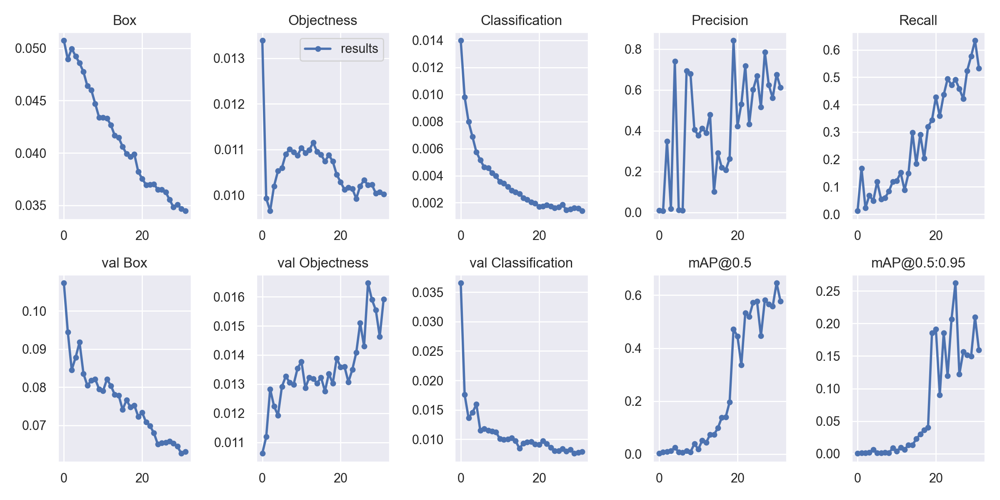

In [10]:
from IPython.display import Image
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='runs/train/exp23/results.png', width=1000)  # view results.png

GROUND TRUTH TRAINING DATA:


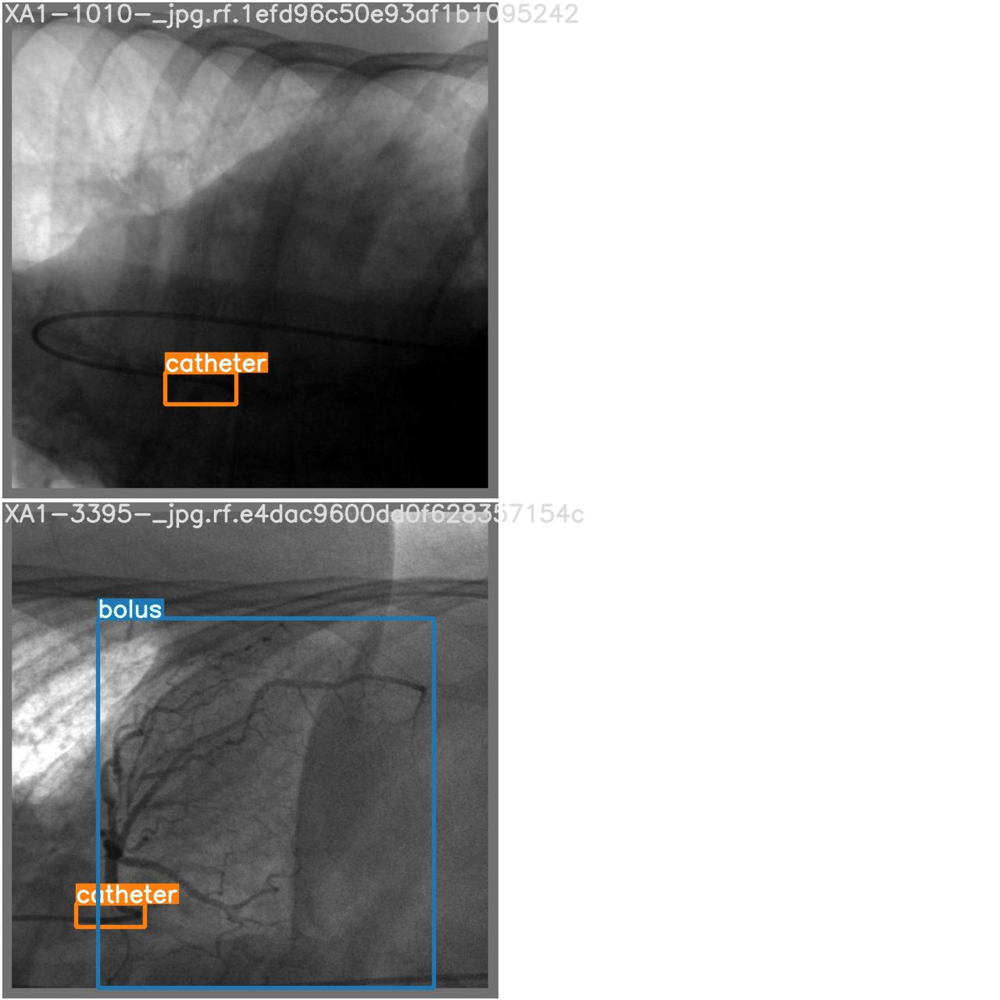

In [9]:
print("GROUND TRUTH TRAINING DATA:")
Image(filename='runs/train/exp23/test_batch0_labels.jpg', width=900)

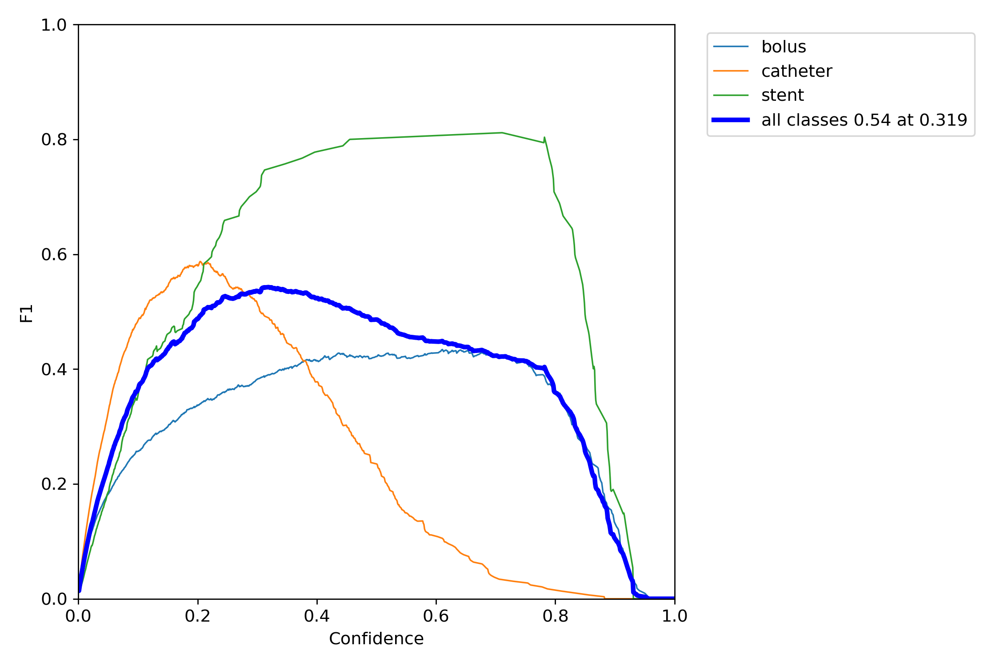

In [13]:
Image(filename='runs/train/exp23/F1_curve.png', width=1000)  # view results.png

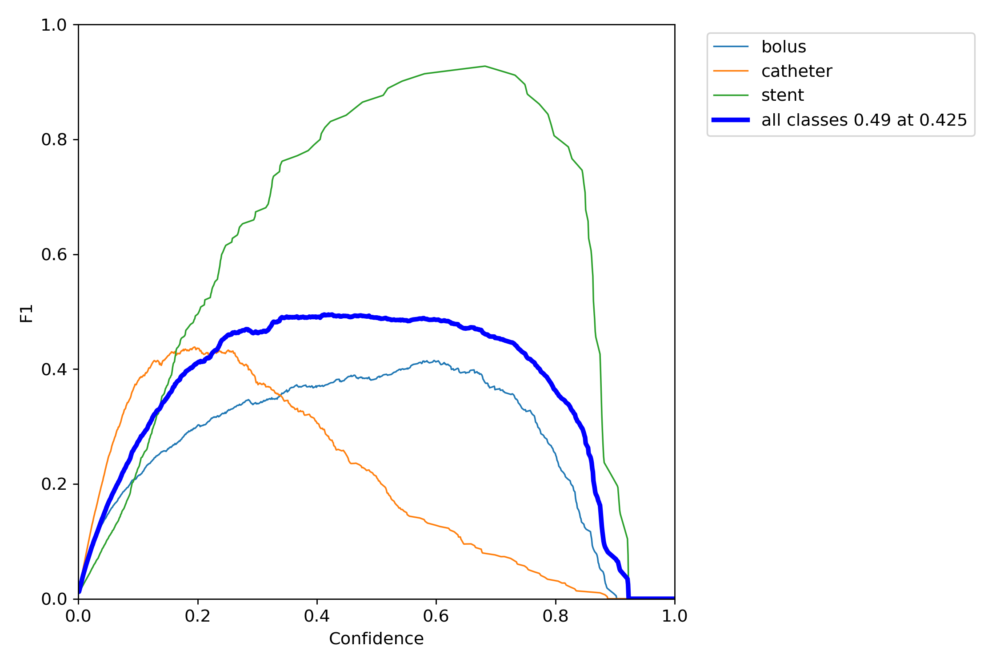

In [11]:
Image(filename='runs/test/yolov7_640_val3/F1_curve.png', width=1000)  # view results.png

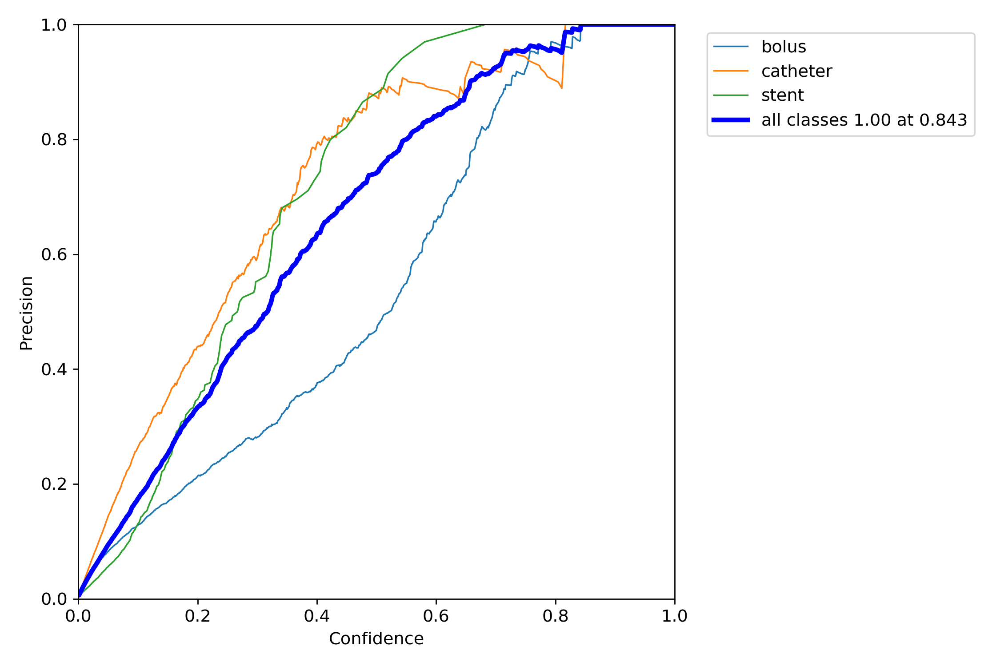

In [12]:
Image(filename='runs/test/yolov7_640_val3/P_curve.png', width=1000)  # view results.png

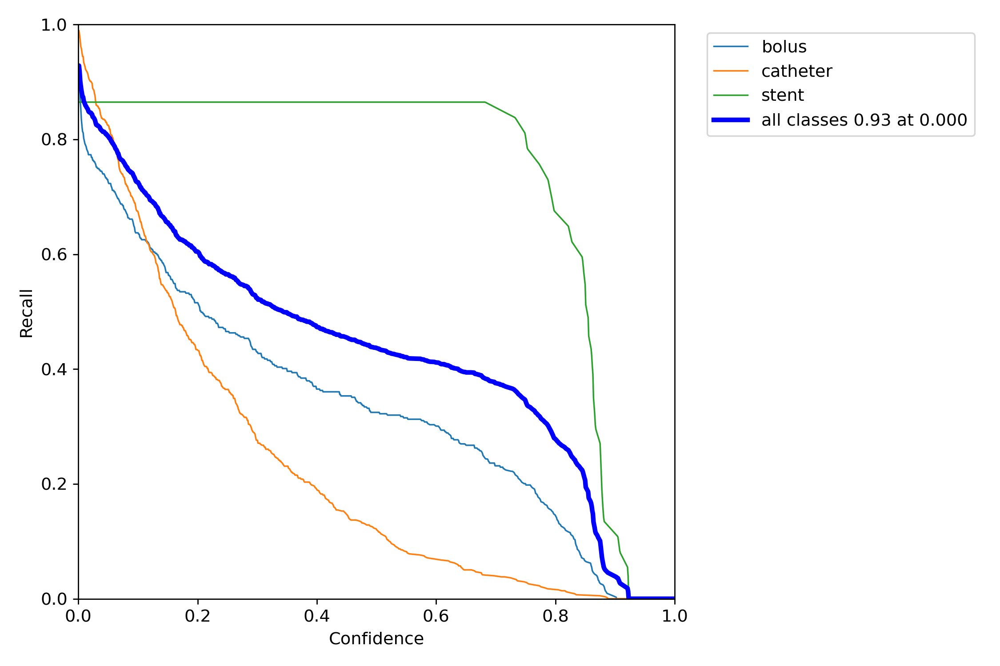

In [13]:
Image(filename='runs/test/yolov7_640_val3/R_curve.png', width=1000)  # view results.png

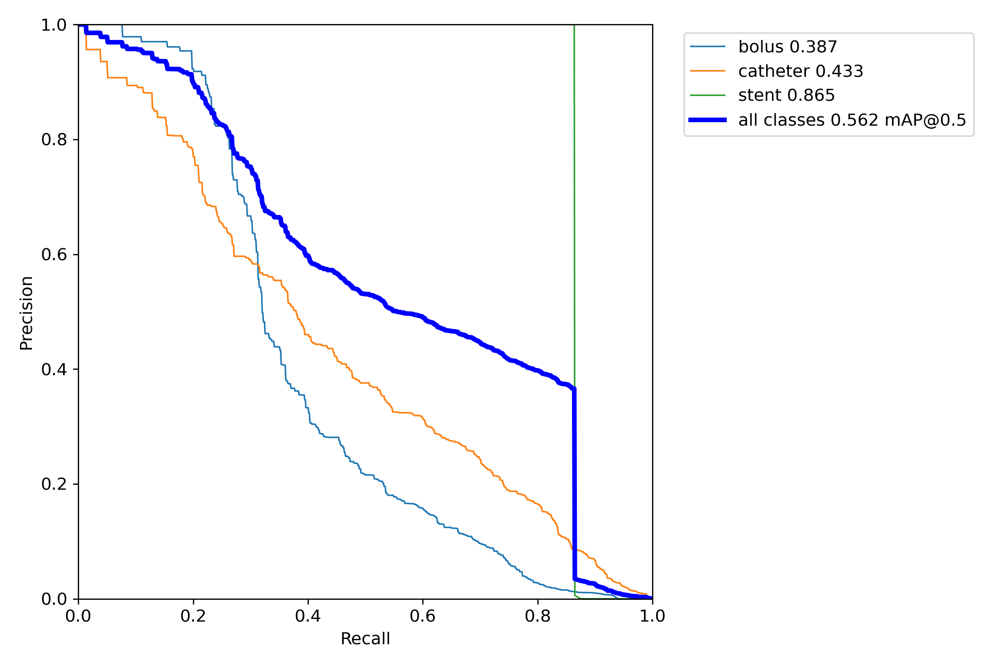

In [14]:
Image(filename='runs/test/yolov7_640_val3/PR_curve.png', width=1000)  # view results.png

These bounding boxes below do not account for the non-maximal suppression that occurs later. That is why there are multiple overlapping bounding boxes.

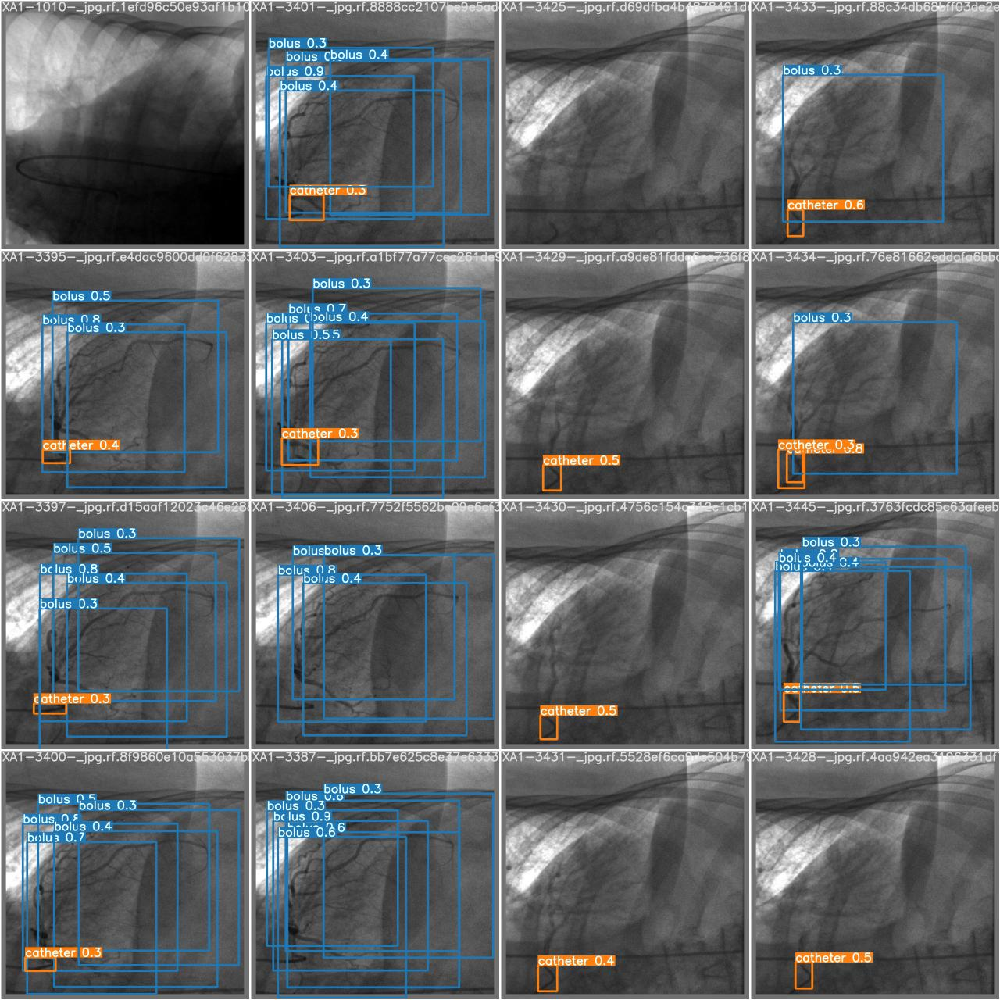

In [15]:
Image(filename='runs/test/yolov7_640_val3/test_batch0_pred.jpg', width=1000)  # view results.png

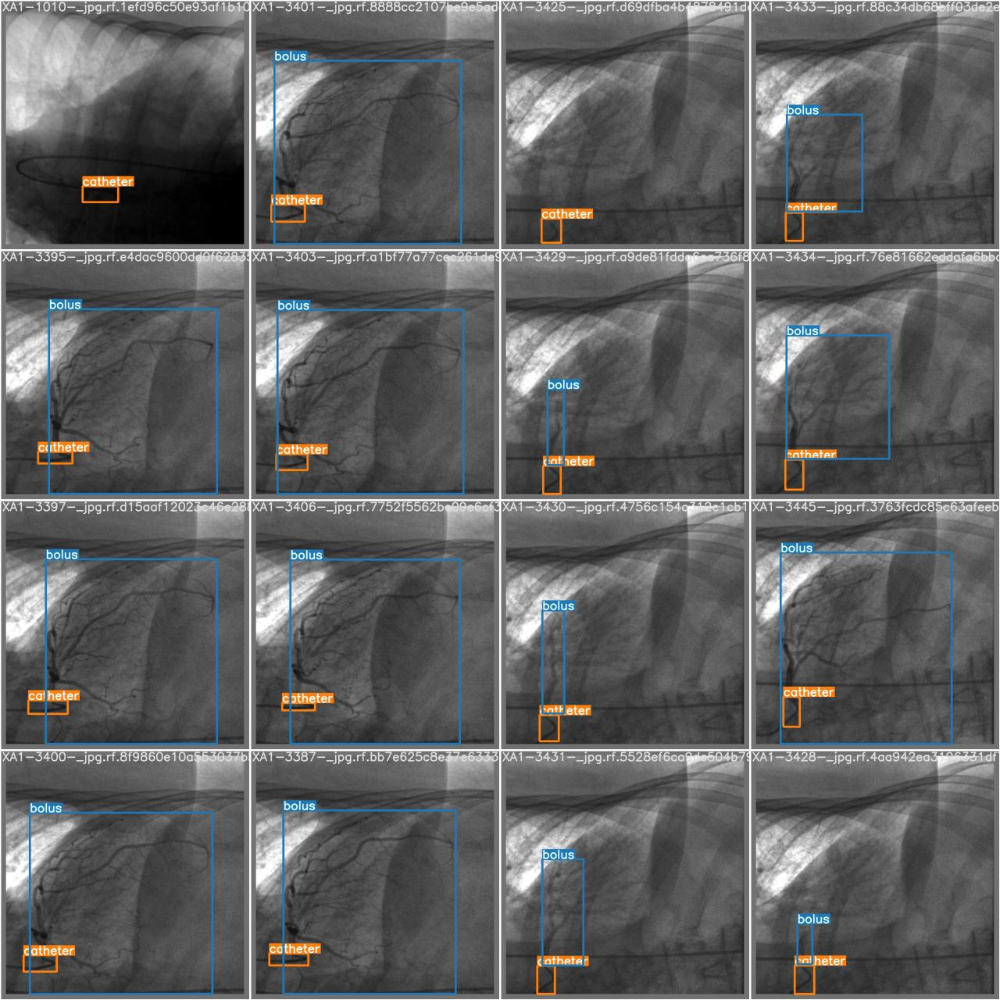

In [16]:
Image(filename='runs/test/yolov7_640_val3/test_batch0_labels.jpg', width=1000)  # view results.png

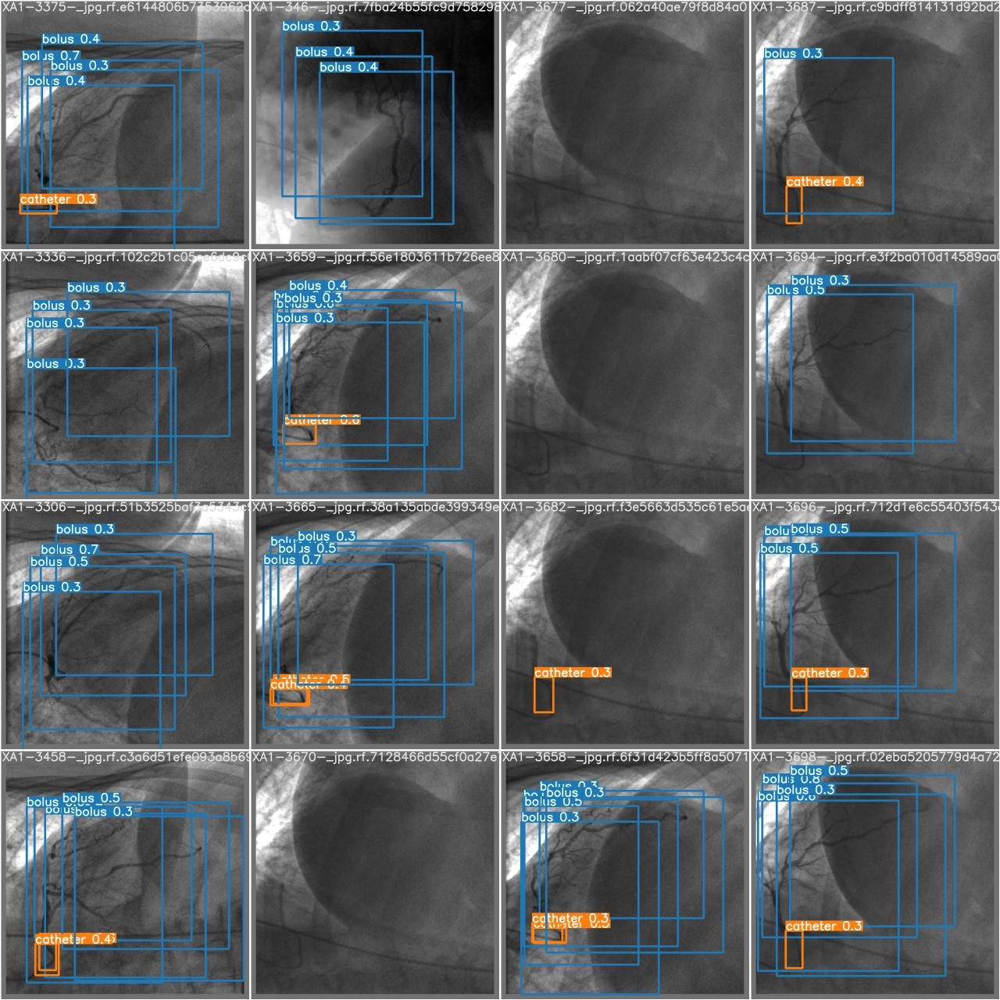

In [17]:
Image(filename='runs/test/yolov7_640_val3/test_batch2_pred.jpg', width=1000)  # view results.png

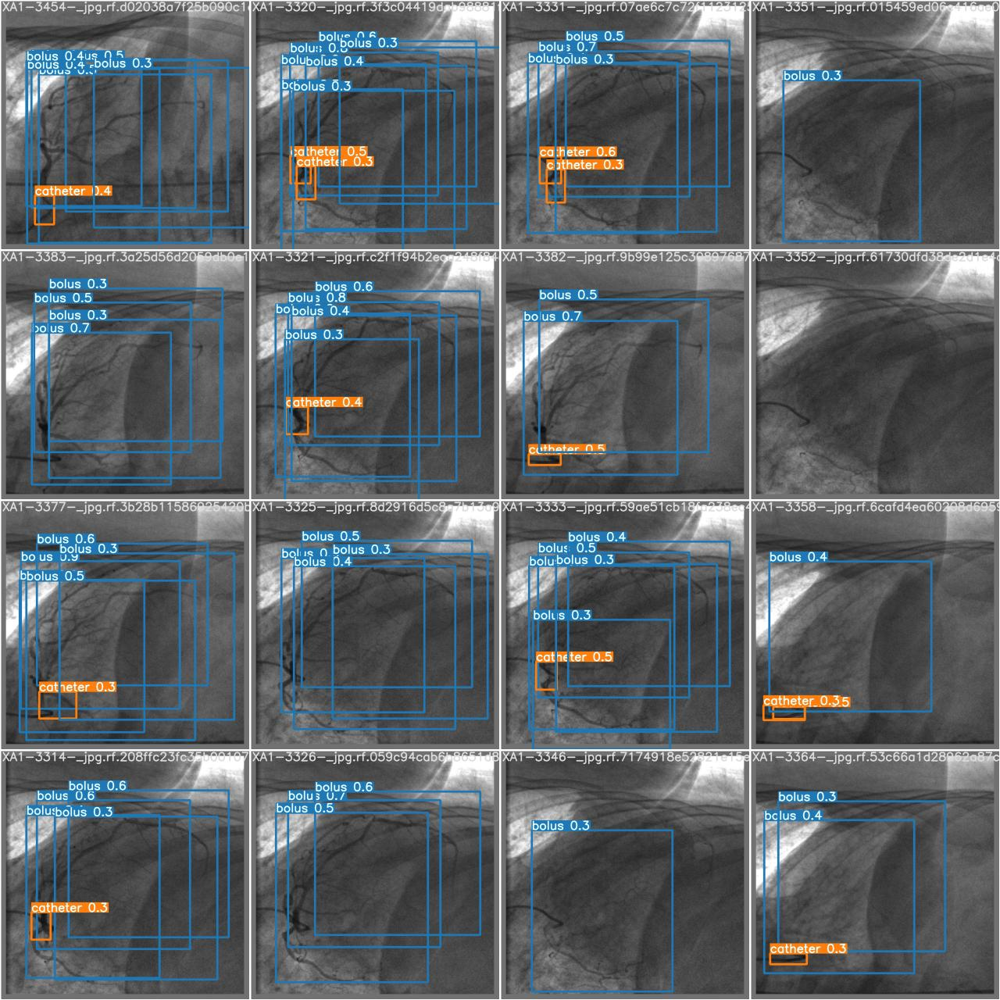

In [18]:
Image(filename='runs/test/yolov7_640_val3/test_batch1_pred.jpg', width=1000)  # view results.png

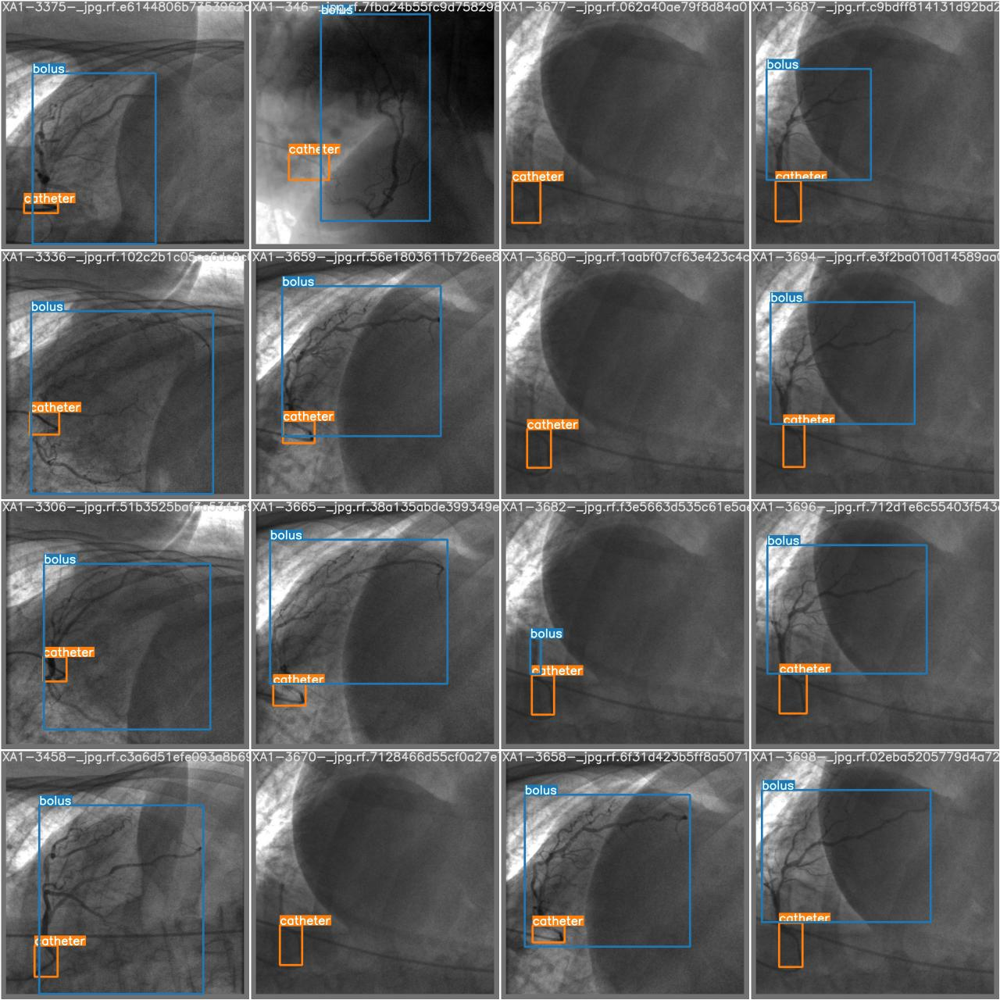

In [19]:
Image(filename='runs/test/yolov7_640_val3/test_batch2_labels.jpg', width=1000)  # view results.png

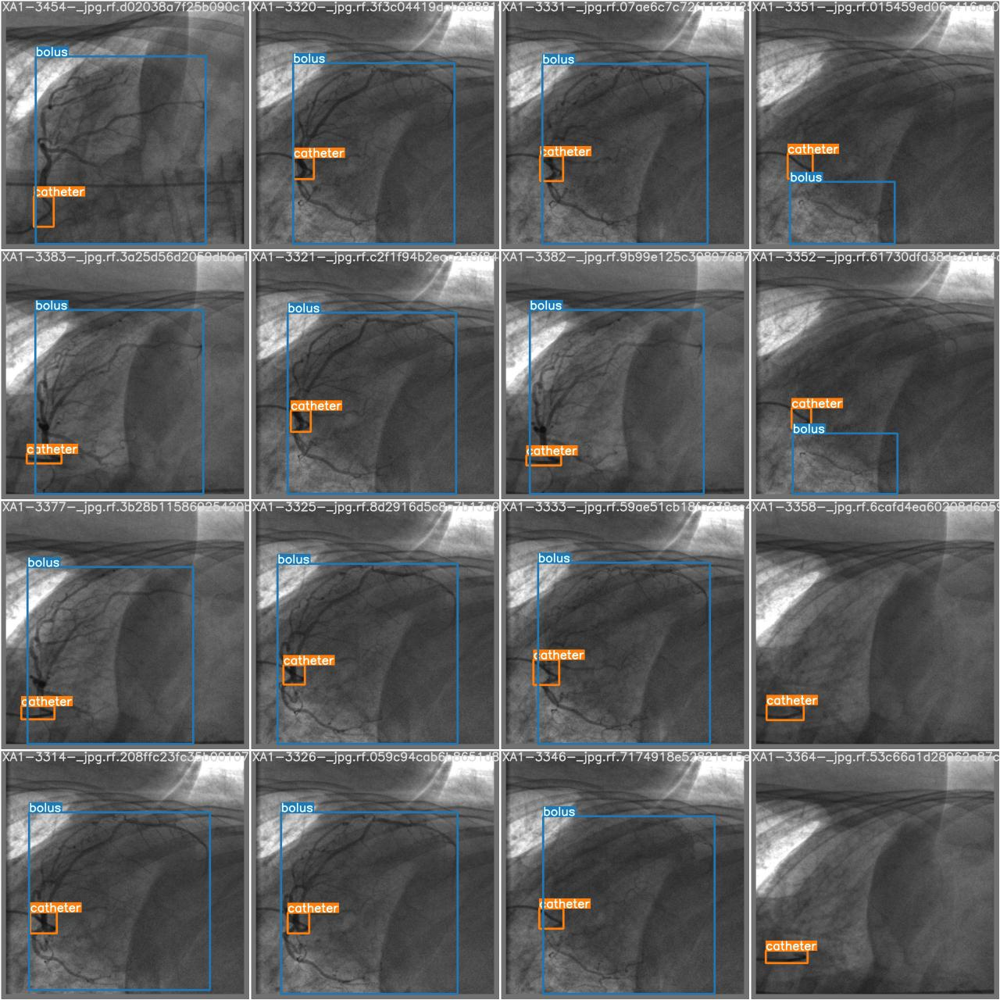

In [20]:
Image(filename='runs/test/yolov7_640_val3/test_batch1_labels.jpg', width=1000)  # view results.png

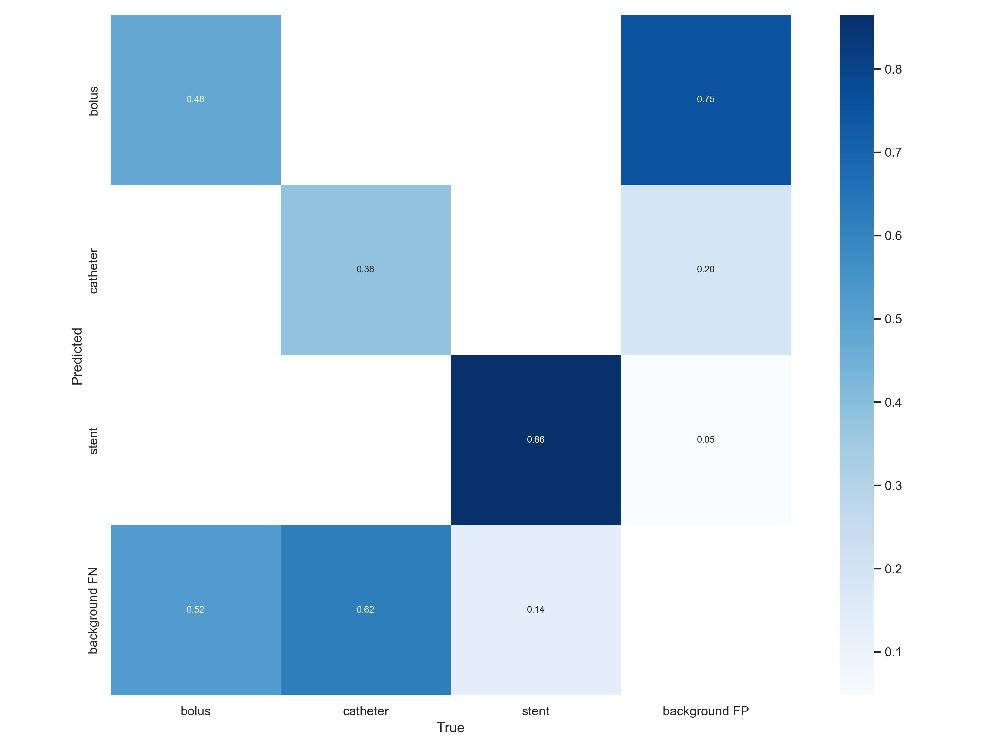

In [21]:
Image(filename='runs/test/yolov7_640_val3/confusion_matrix.png', width=1000)  # view results.png